# Load Spike Shape Models

In [1]:
using Revise,CSV,FileIO,Tables
shapes = [Tables.columns(CSV.File("spikeshapes.csv",datarow=1,allowmissing=:auto,transpose=true))...];

# Spike Shape AutoEncoder

In [2]:
using Flux
model=load("autoencoder.jld2","model")

loaded


Chain(Dense(256, 256, NNlib.relu), Dense(256, 2000, NNlib.relu), Dense(2000, 128, NNlib.relu), Dense(128, 48, NNlib.relu), Dense(48, 32, NNlib.relu), Dense(32, 32, NNlib.relu), Dense(32, 16, NNlib.relu))

In [314]:
model = Chain(Dense(256,128,relu),Dense(128,16,relu),Dense(16,128,relu),Dense(128,256,relu))

Chain(Dense(256, 128, NNlib.relu), Dense(128, 16, NNlib.relu), Dense(16, 128, NNlib.relu), Dense(128, 256, NNlib.relu))

## Training Model

In [282]:
using StatsBase,SpikeSorting,Dates,Plots,DataStructures,Statistics
function supervisedtrain!(model,spikeshapes;maxunitn=3,spikelength=52,snr=5,batchsize=500,epochn=5,acceptloss=0.5,acceptnsuccess=5,
        loss=(x,y)->Flux.crossentropy(softmax(model(x)), y),optimiser = ADAM(params(model),0.0001),maxtrainmemory=50,callbacktimeout=60,
        maxtrytrain=100,lossbuffern=50,acceptminlossrate=0.01,maxnewtry=30)
    
    Flux.truncate!(model);Flux.reset!(model)
    starttime=now();nnewtry=0
    inputn = size(params(model)[1],2);outputn = size(params(model)[end],1)
    nsuccesspredict=0;ntrain=0;ntrainmemory=0;ntraintry=0;losses=CircularBuffer{Float64}(lossbuffern)
    # train with 1,2,3,... number of units
    for nu in 1:maxunitn
        @info "Train $nu unit spikes ..."
        while true
            units = sample(spikeshapes,nu,replace=false)
            nnewtry+=1
            uid = rand(1:nu,batchsize)
            spike = hcat((spikeshape(1:spikelength,units[uid[i]]...,snr=snr) for i in 1:batchsize)...)
            t,x=resample(spike,inputn)
            x=scale01(x)*100
            y = Flux.onehotbatch(uid,1:outputn)
            if loss(x,y) < acceptloss
                nsuccesspredict+=1
                if nsuccesspredict >= acceptnsuccess
                    @info "success predict consecutive $acceptnsuccess new dataset"
                    break
                end
            else
                if nnewtry>maxnewtry
                    @info "stop after failing predict $nnewtry new dataset"
                    nnewtry=0
                    break
                end
                nsuccesspredict=0
                while true
                    for epoch in 1:epochn
                        Flux.train!(loss, [(x,y)], optimiser,cb=Flux.throttle(()->@show(loss(x,y)),callbacktimeout))
                        ntrain+=1;ntrainmemory+=1;ntraintry+=1
                    end
                    l = loss(x,y)
                    if l < acceptloss
                        @info "success training with loss: $l <= $acceptloss"
                        Flux.truncate!(model)
                        ntrainmemory=0
                        ntraintry=0
                        empty!(losses)
                        Flux.reset!(model)
                        break
                    end
                    push!(losses,Tracker.data(l))
                    if length(losses)==lossbuffern
                        mlr = abs(mean(diff(losses)))
                        if mlr<acceptminlossrate
                            @info "stop after mean last $lossbuffern loss rate: $mlr < $acceptminlossrate"
                            Flux.truncate!(model)
                            ntrainmemory=0
                            ntraintry=0
                            empty!(losses)
                            Flux.reset!(model)
                            display(plotsorting(t,x,Tracker.data(model(x))))
                            break
                        end
                    end
                    if ntraintry>maxtrytrain
                        @info "stop after $ntraintry training with loss: $l > $acceptloss"
                        Flux.truncate!(model)
                        ntrainmemory=0
                        ntraintry=0
                        empty!(losses)
                        Flux.reset!(model)
                        display(plotsorting(t,x,Tracker.data(model(x))))
                        break
                    end
                    
                    if ntrainmemory>maxtrainmemory
                        Flux.truncate!(model)
                        ntrainmemory=0
                    end
                    uid = rand(1:nu,batchsize)
                    spike = hcat((spikeshape(1:spikelength,units[uid[i]]...,snr=snr) for i in 1:batchsize)...)
                    t,x=resample(spike,inputn)
                    x=scale01(x)*100
                    y = Flux.onehotbatch(uid,1:outputn)
                end
            end
        end
    end
    @info "finished $ntrain training in $(round(now()-starttime,Dates.Minute(1)))"
end
function plotsorting(t,x,uid,û)
    p = plot(t,x,layout=(1,2),size=(900,350),color=unitscolor[uid'],legend=:none,link=:all,title="Ground Truth")
    plot!(p,t,x,subplot=2,color=unitscolor[û'],legend=:none,title="Model Prediction")
end
function plotsorting(t,x,x̂)
    p = plot(t,x,layout=(1,2),subplot=1,size=(900,350),color=:black,legend=:none,link=:all,title="Ground Truth")
    plot!(p,t,x̂,subplot=2,color=:black,legend=:none,title="Model Prediction")
end

plotsorting (generic function with 2 methods)

In [319]:
supervisedtrain!(model,shapes,maxunitn=1,loss=(x,y)->Flux.mse(model(x), x),acceptloss=50,batchsize=300,maxtrytrain=50,maxnewtry=15,
epochn=2)

┌ Info: Train 1 unit spikes ...
└ @ Main In[282]:12


loss(x, y) = 1562.136015151726 (tracked)
loss(x, y) = 1545.7235015573422 (tracked)
loss(x, y) = 1679.261015674225 (tracked)
loss(x, y) = 1665.331247785447 (tracked)
loss(x, y) = 1629.183263142518 (tracked)
loss(x, y) = 1618.946964138921 (tracked)
loss(x, y) = 1608.2104452581195 (tracked)
loss(x, y) = 1600.3321106534083 (tracked)
loss(x, y) = 1617.9725842157238 (tracked)
loss(x, y) = 1610.9163788495755 (tracked)
loss(x, y) = 1585.292314580661 (tracked)
loss(x, y) = 1578.7115823280847 (tracked)
loss(x, y) = 1628.7911404317967 (tracked)
loss(x, y) = 1622.12231552785 (tracked)
loss(x, y) = 1582.014894582798 (tracked)
loss(x, y) = 1576.0350937233818 (tracked)
loss(x, y) = 1584.7692675826452 (tracked)
loss(x, y) = 1579.380231610542 (tracked)
loss(x, y) = 1475.2238823658954 (tracked)
loss(x, y) = 1470.6134105257152 (tracked)
loss(x, y) = 1528.8139254828652 (tracked)
loss(x, y) = 1524.4187087531957 (tracked)
loss(x, y) = 1494.1634468233624 (tracked)
loss(x, y) = 1490.1066430175165 (tracked)
lo

loss(x, y) = 1479.6400922953462 (tracked)
loss(x, y) = 1478.5357197457145 (tracked)
loss(x, y) = 1267.5812603541888 (tracked)
loss(x, y) = 1266.6968069051954 (tracked)


┌ Info: stop after 52 training with loss: 1266.6968069051954 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 930.0967089232471 (tracked)
loss(x, y) = 928.3510807160482 (tracked)
loss(x, y) = 969.8123134294207 (tracked)
loss(x, y) = 967.362562892048 (tracked)
loss(x, y) = 974.9576342376652 (tracked)
loss(x, y) = 972.493414267345 (tracked)
loss(x, y) = 945.1727205584878 (tracked)
loss(x, y) = 942.8420547307379 (tracked)
loss(x, y) = 919.2524681766331 (tracked)
loss(x, y) = 917.0865944004125 (tracked)
loss(x, y) = 930.8533142776591 (tracked)
loss(x, y) = 928.8129890979139 (tracked)
loss(x, y) = 916.6879780956075 (tracked)
loss(x, y) = 914.6897004560699 (tracked)
loss(x, y) = 943.4248198148998 (tracked)
loss(x, y) = 941.5171349238904 (tracked)
loss(x, y) = 896.2687325564626 (tracked)
loss(x, y) = 894.632151629026 (tracked)
loss(x, y) = 948.2574095040192 (tracked)
loss(x, y) = 946.6498611502906 (tracked)
loss(x, y) = 884.4096845846226 (tracked)
loss(x, y) = 882.9281620086982 (tracked)
loss(x, y) = 914.5075679918903 (tracked)
loss(x, y) = 913.1235839402788 (tracked)
loss(x, y) = 909.32


loss(x, y) = 822.6659239896092 (tracked)


┌ Info: stop after 52 training with loss: 822.6659239896092 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 1234.1740832362602 (tracked)
loss(x, y) = 1232.7772189441173 (tracked)
loss(x, y) = 1285.0097146766261 (tracked)
loss(x, y) = 1282.2810051428457 (tracked)
loss(x, y) = 1167.4406058794093 (tracked)
loss(x, y) = 1164.5168301456383 (tracked)
loss(x, y) = 1181.696721496727 (tracked)
loss(x, y) = 1178.6930084087094 (tracked)
loss(x, y) = 1171.859106966904 (tracked)
loss(x, y) = 1169.0002975640532 (tracked)
loss(x, y) = 1204.1676997270415 (tracked)
loss(x, y) = 1201.425319671558 (tracked)
loss(x, y) = 1245.34006992007 (tracked)
loss(x, y) = 1242.7326990372708 (tracked)
loss(x, y) = 1175.1391930098869 (tracked)
loss(x, y) = 1172.8672620672558 (tracked)
loss(x, y) = 1092.1016702535144 (tracked)
loss(x, y) = 1090.2336906011462 (tracked)
loss(x, y) = 1167.5473876822105 (tracked)
loss(x, y) = 1165.6555334224347 (tracked)
loss(x, y) = 1193.4010931733135 (tracked)
loss(x, y) = 1191.7057371519074 (tracked)
loss(x, y) = 1184.002579061746 (tracked)
loss(x, y) = 1182.430168834839 (tracked)


loss(x, y) = 1110.844484106023 (tracked)
loss(x, y) = 1110.6916044921163 (tracked)


┌ Info: stop after 52 training with loss: 1110.6916044921163 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 817.1320459114811 (tracked)
loss(x, y) = 813.900474467206 (tracked)
loss(x, y) = 872.7952588059375 (tracked)
loss(x, y) = 868.0131984964236 (tracked)
loss(x, y) = 826.5150570750201 (tracked)
loss(x, y) = 821.9863906584992 (tracked)
loss(x, y) = 898.6519114801264 (tracked)
loss(x, y) = 893.7053347273334 (tracked)
loss(x, y) = 825.6693264236433 (tracked)
loss(x, y) = 820.9344244386546 (tracked)
loss(x, y) = 844.862582663904 (tracked)
loss(x, y) = 839.9326706052574 (tracked)
loss(x, y) = 819.4496455228424 (tracked)
loss(x, y) = 814.7712349502237 (tracked)
loss(x, y) = 807.6628956276314 (tracked)
loss(x, y) = 803.25361637811 (tracked)
loss(x, y) = 813.1435611926728 (tracked)
loss(x, y) = 808.8446218679803 (tracked)
loss(x, y) = 800.4297146335318 (tracked)
loss(x, y) = 796.2451725390023 (tracked)
loss(x, y) = 763.499980049226 (tracked)
loss(x, y) = 759.410988346252 (tracked)
loss(x, y) = 697.7133843706831 (tracked)
loss(x, y) = 694.1046039570668 (tracked)
loss(x, y) = 738.00521

┌ Info: stop after 52 training with loss: 694.019529790041 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 681.3465850033643 (tracked)
loss(x, y) = 679.924923391331 (tracked)
loss(x, y) = 697.8154509022804 (tracked)
loss(x, y) = 696.5041802980628 (tracked)
loss(x, y) = 660.8851260890882 (tracked)
loss(x, y) = 659.6810057323411 (tracked)
loss(x, y) = 688.6225519078264 (tracked)
loss(x, y) = 687.4952046586225 (tracked)
loss(x, y) = 718.4842749795254 (tracked)
loss(x, y) = 717.5229929438252 (tracked)
loss(x, y) = 654.431092269512 (tracked)
loss(x, y) = 653.5817056381883 (tracked)
loss(x, y) = 668.0039554397009 (tracked)
loss(x, y) = 667.2699237477937 (tracked)
loss(x, y) = 703.8359482220134 (tracked)
loss(x, y) = 703.1550766980012 (tracked)
loss(x, y) = 663.7589293578279 (tracked)
loss(x, y) = 663.1695023009346 (tracked)
loss(x, y) = 644.5266243820961 (tracked)
loss(x, y) = 643.969697947038 (tracked)
loss(x, y) = 643.8422575289724 (tracked)
loss(x, y) = 643.3936988779163 (tracked)
loss(x, y) = 663.6334622903578 (tracked)
loss(x, y) = 663.2368468131133 (tracked)
loss(x, y) = 644.85

loss(x, y) = 647.570609600178 (tracked)
loss(x, y) = 647.4839996561808 (tracked)


┌ Info: stop after 52 training with loss: 647.4839996561808 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 2039.270536796075 (tracked)
loss(x, y) = 2000.7160858269408 (tracked)
loss(x, y) = 1862.5305437009988 (tracked)
loss(x, y) = 1832.178829114514 (tracked)
loss(x, y) = 1790.6840569376368 (tracked)
loss(x, y) = 1774.815805544906 (tracked)
loss(x, y) = 1836.03670084394 (tracked)
loss(x, y) = 1826.6589314670518 (tracked)
loss(x, y) = 1748.7036734509172 (tracked)
loss(x, y) = 1736.409468288448 (tracked)
loss(x, y) = 1798.9299626334314 (tracked)
loss(x, y) = 1780.3730305924803 (tracked)
loss(x, y) = 1688.852105209673 (tracked)
loss(x, y) = 1672.8023675121876 (tracked)
loss(x, y) = 1663.7593129922352 (tracked)
loss(x, y) = 1653.118075018544 (tracked)
loss(x, y) = 1692.4614453195595 (tracked)
loss(x, y) = 1685.8738883348412 (tracked)
loss(x, y) = 1569.0333830496597 (tracked)
loss(x, y) = 1563.5275767634007 (tracked)
loss(x, y) = 1638.4613276679422 (tracked)
loss(x, y) = 1631.434435074474 (tracked)
loss(x, y) = 1570.9276885592794 (tracked)
loss(x, y) = 1564.1016421319175 (tracked)
l

loss(x, y) = 1531.882795630468 (tracked)


┌ Info: stop after 52 training with loss: 1531.882795630468 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 1265.0990835630712 (tracked)
loss(x, y) = 1262.6867111898484 (tracked)
loss(x, y) = 1261.2535040498892 (tracked)
loss(x, y) = 1257.7175507240463 (tracked)
loss(x, y) = 1267.1103738243837 (tracked)
loss(x, y) = 1263.229045884839 (tracked)
loss(x, y) = 1242.7442131987395 (tracked)
loss(x, y) = 1239.2404272394701 (tracked)
loss(x, y) = 1252.5645379576351 (tracked)
loss(x, y) = 1249.4742373908246 (tracked)
loss(x, y) = 1233.688509703589 (tracked)
loss(x, y) = 1231.0957943218327 (tracked)
loss(x, y) = 1216.5906978690275 (tracked)
loss(x, y) = 1214.3162791366306 (tracked)
loss(x, y) = 1158.3663923052263 (tracked)
loss(x, y) = 1156.436587035958 (tracked)
loss(x, y) = 1222.66520191057 (tracked)
loss(x, y) = 1220.8041875524182 (tracked)
loss(x, y) = 1195.334318673096 (tracked)
loss(x, y) = 1193.6560078787318 (tracked)
loss(x, y) = 1194.0341403547993 (tracked)
loss(x, y) = 1192.5705714722203 (tracked)
loss(x, y) = 1183.6038869363256 (tracked)
loss(x, y) = 1182.3497874857435 (tracked


loss(x, y) = 1211.187678227039 (tracked)
loss(x, y) = 1211.0909825051835 (tracked)


┌ Info: stop after 52 training with loss: 1211.0909825051835 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 1602.9723855516352 (tracked)
loss(x, y) = 1598.4805035752524 (tracked)
loss(x, y) = 1599.9382400998252 (tracked)
loss(x, y) = 1593.8494406966413 (tracked)
loss(x, y) = 1602.4715600965928 (tracked)
loss(x, y) = 1596.7362881221702 (tracked)
loss(x, y) = 1558.2878092650135 (tracked)
loss(x, y) = 1554.1769000387999 (tracked)
loss(x, y) = 1554.4477869766872 (tracked)
loss(x, y) = 1551.2598842452921 (tracked)
loss(x, y) = 1553.3335000872717 (tracked)
loss(x, y) = 1550.0882588347722 (tracked)
loss(x, y) = 1516.026833541335 (tracked)
loss(x, y) = 1512.86277393043 (tracked)
loss(x, y) = 1520.6804295504255 (tracked)
loss(x, y) = 1517.9548300870433 (tracked)
loss(x, y) = 1542.5431078702436 (tracked)
loss(x, y) = 1540.311975310776 (tracked)
loss(x, y) = 1569.601407246596 (tracked)
loss(x, y) = 1567.6470793818028 (tracked)
loss(x, y) = 1565.1645958946247 (tracked)
loss(x, y) = 1563.5343684066697 (tracked)
loss(x, y) = 1582.7342568990323 (tracked)
loss(x, y) = 1581.4954043727776 (tracke

loss(x, y) = 1530.8883557877527 (tracked)
loss(x, y) = 1530.8280861714868 (tracked)


┌ Info: stop after 52 training with loss: 1530.8280861714868 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 1067.202557619199 (tracked)
loss(x, y) = 1061.1568992903929 (tracked)
loss(x, y) = 1112.908953807664 (tracked)
loss(x, y) = 1102.640564584594 (tracked)
loss(x, y) = 1066.6255278626763 (tracked)
loss(x, y) = 1055.9831437813793 (tracked)
loss(x, y) = 1021.127192423488 (tracked)
loss(x, y) = 1011.478169636568 (tracked)
loss(x, y) = 1069.889760985572 (tracked)
loss(x, y) = 1061.9088360404926 (tracked)
loss(x, y) = 1043.8967007859721 (tracked)
loss(x, y) = 1038.3177405599288 (tracked)
loss(x, y) = 1004.8497001428483 (tracked)
loss(x, y) = 1000.3582763620171 (tracked)
loss(x, y) = 1044.5317191650965 (tracked)
loss(x, y) = 1040.573322932527 (tracked)
loss(x, y) = 975.1995371405912 (tracked)
loss(x, y) = 971.2937063150479 (tracked)
loss(x, y) = 1057.8390339045413 (tracked)
loss(x, y) = 1053.883782912463 (tracked)
loss(x, y) = 924.0538807174098 (tracked)
loss(x, y) = 920.7819167958816 (tracked)
loss(x, y) = 1028.2461992564802 (tracked)
loss(x, y) = 1024.7610998175246 (tracked)
loss

loss(x, y) = 934.248204762981 (tracked)
loss(x, y) = 933.6905230339706 (tracked)


┌ Info: stop after 52 training with loss: 933.6905230339706 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 696.9525752397095 (tracked)
loss(x, y) = 695.1002900734211 (tracked)
loss(x, y) = 698.4114760685073 (tracked)
loss(x, y) = 695.8210697022539 (tracked)
loss(x, y) = 681.6879040019737 (tracked)
loss(x, y) = 678.8049395191109 (tracked)
loss(x, y) = 710.0236938734452 (tracked)
loss(x, y) = 706.7858426589409 (tracked)
loss(x, y) = 656.2447848450054 (tracked)
loss(x, y) = 653.0928499176656 (tracked)
loss(x, y) = 645.078033600154 (tracked)
loss(x, y) = 642.0235500462932 (tracked)
loss(x, y) = 625.8685765267984 (tracked)
loss(x, y) = 623.085112840823 (tracked)
loss(x, y) = 636.4724353036798 (tracked)
loss(x, y) = 633.6777536125152 (tracked)
loss(x, y) = 651.6987917887278 (tracked)
loss(x, y) = 648.9791733144127 (tracked)
loss(x, y) = 645.3929840304871 (tracked)
loss(x, y) = 642.960757204158 (tracked)
loss(x, y) = 630.9697270290089 (tracked)
loss(x, y) = 628.8364200817745 (tracked)
loss(x, y) = 717.6167804703641 (tracked)
loss(x, y) = 715.6051683773048 (tracked)
loss(x, y) = 688.76

loss(x, y) = 620.2820838111073 (tracked)


┌ Info: stop after 52 training with loss: 620.2820838111073 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 1608.1002851314117 (tracked)
loss(x, y) = 1587.215842245073 (tracked)
loss(x, y) = 1561.2803985648948 (tracked)
loss(x, y) = 1538.0924184629823 (tracked)
loss(x, y) = 1447.496610575187 (tracked)
loss(x, y) = 1430.705640365967 (tracked)
loss(x, y) = 1464.1485651287874 (tracked)
loss(x, y) = 1451.2809484421307 (tracked)
loss(x, y) = 1430.9171056786813 (tracked)
loss(x, y) = 1420.1582380149814 (tracked)
loss(x, y) = 1400.5035080670464 (tracked)
loss(x, y) = 1391.1061162829635 (tracked)
loss(x, y) = 1371.5203793627463 (tracked)
loss(x, y) = 1362.665177642731 (tracked)
loss(x, y) = 1348.1098401883928 (tracked)
loss(x, y) = 1341.4197907120113 (tracked)
loss(x, y) = 1408.899406951328 (tracked)
loss(x, y) = 1403.3631181034614 (tracked)
loss(x, y) = 1354.3296263818606 (tracked)
loss(x, y) = 1349.7268765885228 (tracked)
loss(x, y) = 1332.98524293968 (tracked)
loss(x, y) = 1328.2421332009383 (tracked)
loss(x, y) = 1370.0879124443343 (tracked)
loss(x, y) = 1365.2848876137364 (tracked)

loss(x, y) = 1246.3880927575735 (tracked)
loss(x, y) = 1246.1708464803012 (tracked)


┌ Info: stop after 52 training with loss: 1246.1708464803012 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 843.992412388271 (tracked)
loss(x, y) = 843.2620740497498 (tracked)
loss(x, y) = 815.8958915265259 (tracked)
loss(x, y) = 814.3559967091464 (tracked)
loss(x, y) = 801.5929185467052 (tracked)
loss(x, y) = 799.671947790128 (tracked)
loss(x, y) = 841.8865347743625 (tracked)
loss(x, y) = 839.7016532120228 (tracked)
loss(x, y) = 804.4104077079902 (tracked)
loss(x, y) = 802.2710276534615 (tracked)
loss(x, y) = 813.3654434382983 (tracked)
loss(x, y) = 811.2861678259961 (tracked)
loss(x, y) = 760.5796138136277 (tracked)
loss(x, y) = 758.7634743049163 (tracked)
loss(x, y) = 784.4032235745988 (tracked)
loss(x, y) = 782.6695732218977 (tracked)
loss(x, y) = 846.4105443408848 (tracked)
loss(x, y) = 844.7638974284467 (tracked)
loss(x, y) = 708.3813435022487 (tracked)
loss(x, y) = 707.0063003102125 (tracked)
loss(x, y) = 810.6447327603481 (tracked)
loss(x, y) = 809.1263405650111 (tracked)
loss(x, y) = 754.7244207788137 (tracked)
loss(x, y) = 753.4132994114211 (tracked)
loss(x, y) = 798.7

loss(x, y) = 751.389309266039 (tracked)
loss(x, y) = 751.1561134390004 (tracked)


┌ Info: stop after 52 training with loss: 751.1561134390004 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 1339.7492440289582 (tracked)
loss(x, y) = 1325.964203606355 (tracked)
loss(x, y) = 1316.2409839276754 (tracked)
loss(x, y) = 1298.9602057824598 (tracked)
loss(x, y) = 1365.2395543973482 (tracked)
loss(x, y) = 1350.7843560070778 (tracked)
loss(x, y) = 1283.4056808053328 (tracked)
loss(x, y) = 1272.5592521205326 (tracked)
loss(x, y) = 1245.454814236561 (tracked)
loss(x, y) = 1233.8749596227883 (tracked)
loss(x, y) = 1208.7244068383873 (tracked)
loss(x, y) = 1196.2521206096785 (tracked)
loss(x, y) = 1198.877732707353 (tracked)
loss(x, y) = 1186.870839430856 (tracked)
loss(x, y) = 1179.2786790564166 (tracked)
loss(x, y) = 1169.002675597182 (tracked)
loss(x, y) = 1091.9628234485203 (tracked)
loss(x, y) = 1084.0904220974876 (tracked)
loss(x, y) = 1174.2817587517145 (tracked)
loss(x, y) = 1166.666902591791 (tracked)
loss(x, y) = 1185.0438748077263 (tracked)
loss(x, y) = 1177.6048629507138 (tracked)
loss(x, y) = 1104.085360373274 (tracked)
loss(x, y) = 1097.3571015983762 (tracked)


loss(x, y) = 1050.4749587300184 (tracked)
loss(x, y) = 1049.8210920745914 (tracked)


┌ Info: stop after 52 training with loss: 1049.8210920745914 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 1486.6156884609088 (tracked)
loss(x, y) = 1476.3389603403627 (tracked)
loss(x, y) = 1407.81110754377 (tracked)
loss(x, y) = 1394.8526170696302 (tracked)
loss(x, y) = 1473.411389162769 (tracked)
loss(x, y) = 1460.7104747701487 (tracked)
loss(x, y) = 1421.8129761124685 (tracked)
loss(x, y) = 1410.150382840902 (tracked)
loss(x, y) = 1357.9176954657169 (tracked)
loss(x, y) = 1345.819216433863 (tracked)
loss(x, y) = 1343.7829685363934 (tracked)
loss(x, y) = 1331.20167764528 (tracked)
loss(x, y) = 1370.2070023208626 (tracked)
loss(x, y) = 1357.8931133956225 (tracked)
loss(x, y) = 1251.835084306819 (tracked)
loss(x, y) = 1241.771405048472 (tracked)
loss(x, y) = 1290.136409374219 (tracked)
loss(x, y) = 1279.9533888052026 (tracked)
loss(x, y) = 1308.4293537306387 (tracked)
loss(x, y) = 1298.6811084652004 (tracked)
loss(x, y) = 1267.5332002349303 (tracked)
loss(x, y) = 1258.8096637894223 (tracked)
loss(x, y) = 1223.5831388727247 (tracked)
loss(x, y) = 1216.4135399864283 (tracked)
lo

loss(x, y) = 1143.8957685555367 (tracked)
loss(x, y) = 1143.5980152106847 (tracked)


┌ Info: stop after 52 training with loss: 1143.5980152106847 (tracked) > 50
└ @ Main In[282]:64


loss(x, y) = 1645.2902105509654 (tracked)
loss(x, y) = 1642.2049687595645 (tracked)
loss(x, y) = 1534.082434073271 (tracked)
loss(x, y) = 1529.9503284271675 (tracked)
loss(x, y) = 1560.0287806474003 (tracked)
loss(x, y) = 1555.8690796574049 (tracked)
loss(x, y) = 1568.2110943233117 (tracked)
loss(x, y) = 1564.6835654731003 (tracked)
loss(x, y) = 1558.95479977824 (tracked)
loss(x, y) = 1556.0481885536826 (tracked)
loss(x, y) = 1583.1285909638 (tracked)
loss(x, y) = 1580.334241128522 (tracked)
loss(x, y) = 1501.7085942480776 (tracked)
loss(x, y) = 1499.180628610013 (tracked)
loss(x, y) = 1556.368043390091 (tracked)
loss(x, y) = 1553.902946761945 (tracked)
loss(x, y) = 1520.1271502437644 (tracked)
loss(x, y) = 1518.0530991973956 (tracked)
loss(x, y) = 1533.767669625737 (tracked)
loss(x, y) = 1532.124229178392 (tracked)
loss(x, y) = 1493.3823224867458 (tracked)
loss(x, y) = 1492.2445560256365 (tracked)
loss(x, y) = 1394.2770242326606 (tracked)
loss(x, y) = 1393.4912054261301 (tracked)
loss

loss(x, y) = 1439.5895532580564 (tracked)


┌ Info: stop after 52 training with loss: 1439.5895532580564 (tracked) > 50
└ @ Main In[282]:64
┌ Info: stop after failing predict 16 new dataset
└ @ Main In[282]:29
┌ Info: finished 780 training in 1 minute
└ @ Main In[282]:87


## Model Prediction

In [280]:
params(model)[end-1]

Tracked 256×16 Array{Float64,2}:
  0.118629     0.0468213   -0.124067    …   0.122961    0.0888084  
 -0.10455     -0.0641121    0.118633        0.0453895  -0.0142666  
 -0.116547     0.0884437    0.132473        0.0349504   0.0504453  
 -0.142305    -0.0382096    0.0188367       0.0453837   0.0699245  
  0.00695987   0.142897    -0.00849363     -0.101148   -0.0632822  
  0.0930942   -0.141361    -0.0360373   …   0.133967   -0.0517412  
 -0.0725782    0.145861    -0.09026        -0.0275534  -0.110949   
  0.0452788    0.0263711   -0.0619358      -0.0753365   0.0214527  
  0.0688931    0.0910527    0.0806852      -0.115073   -0.108107   
  0.0948036   -0.111877    -0.0244955      -0.0935379  -0.0223134  
  0.0939944    0.0824862    0.103182    …  -0.116868   -0.0778301  
 -0.0791026   -0.0770239   -0.0072793       0.0962756  -0.0815025  
  0.102482    -0.112818     0.0830554       0.128498    0.031703   
  ⋮                                     ⋱               ⋮          
  0.109718    -

In [286]:
function predict(model,spikeshapes;unitn=2,spikelength=52,snr=5,batchsize=300,isplot=true)
    inputn = size(params(model)[1],2);outputn = size(params(model)[end],1)
    units = sample(spikeshapes,unitn,replace=false)
    uid = rand(1:unitn,batchsize)
    spike = hcat((spikeshape(1:spikelength,units[uid[i]]...,snr=snr) for i in 1:batchsize)...)
    
    t,x=resample(spike,inputn)
    x=scale01(x)*100
    Flux.reset!(model)
    ŷ = model(x)
    if isplot
        return plotsorting(t,x,Tracker.data(ŷ))
    else
        return t,x
    end
end

predict (generic function with 1 method)

In [270]:
using Images
scale01(x)=scaleminmax(extrema(x)...).(x)

scale01 (generic function with 1 method)

In [272]:
extrema(rand(10,10)*10)

(0.10080646895563872, 9.874079810522868)

In [273]:
scale01(rand(10,10)*10)

10×10 Array{Float64,2}:
 0.524687  0.682274  0.309758   0.504634   …  0.69738    0.807302  0.07617 
 0.972018  0.195937  0.95636    0.911474      0.36159    0.986154  0.121026
 0.790618  0.834565  0.3981     0.588789      0.267225   0.685558  0.270458
 0.494138  0.833276  0.160039   0.0991118     0.800959   0.859471  0.683413
 0.0       0.536271  0.0604824  0.596508      0.185303   0.582406  0.678267
 0.482193  0.935534  0.344492   0.493353   …  0.139279   0.429613  0.905216
 0.856792  0.780382  1.0        0.437201      0.411243   0.723107  0.524677
 0.895197  0.751773  0.988473   0.242777      0.436819   0.54794   0.434423
 0.834445  0.901485  0.399896   0.137381      0.643133   0.99347   0.922353
 0.452376  0.588777  0.35128    0.711716      0.0890503  0.17888   0.333941

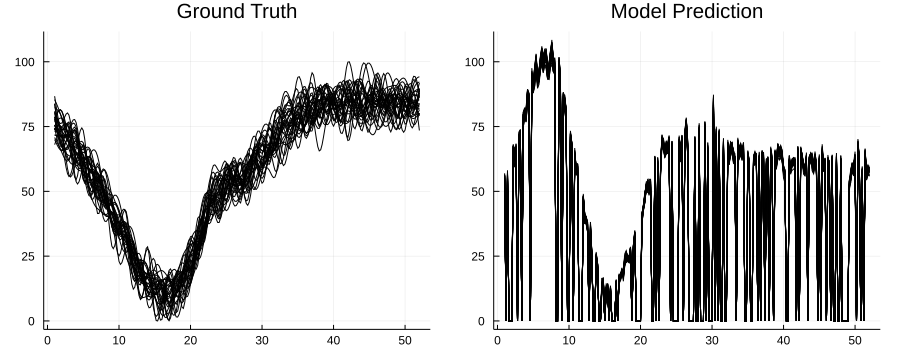

In [318]:
predict(model,shapes,unitn=1,batchsize=30)

## Save Model

In [18]:
Flux.truncate!(model)
Flux.reset!(model)
save("autoencoder.jld2","model",model)